### IMPORTING NECESSARY LIBRARIES

In [3]:
import numpy as np  # NUMERICAL COMPUTATIONS
import pandas as pd  # DATA MANIPULATION
import matplotlib.pyplot as plt  # PLOTTING

# ENSURE PLOTS ARE DISPLAYED INLINE IN JUPYTER NOTEBOOK
%matplotlib inline 

### LOADING AND DISPLAYING DATA

In [ ]:
# LOAD DATA FROM CSV FILE INTO A DATAFRAME
df = pd.read_csv("../DATA/DATA[12K].csv")  

In [5]:
# DISPLAY FIRST FIVE ROWS OF THE DATAFRAME
df.head()

,fw,gl,gh,il,iw,sh,pl,pw,sl,sw,ph,freq,s11,gain
0,1,30,2.0,3,1,3.0,28,32,30,40,2.0,13.470,-10.628340,6.870651
1,1,30,2.0,3,1,2.9,28,32,30,40,2.0,13.464,-10.769915,6.836843
2,1,30,2.0,3,1,2.8,28,32,30,40,2.0,13.476,-11.091512,6.754685
3,1,30,2.0,3,1,2.7,28,32,30,40,2.0,13.476,-11.499643,6.930878
4,1,30,2.0,3,1,2.6,28,32,30,40,2.0,13.500,-11.883592,7.087127


In [6]:
# DISPLAY DATAFRAME SUMMARY INCLUDING COLUMN TYPES AND MISSING VALUES
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12001 entries, 0 to 12000
Data columns (total 14 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   fw      12001 non-null  int64  
 1   gl      12001 non-null  int64  
 2   gh      12001 non-null  float64
 3   il      12001 non-null  int64  
 4   iw      12001 non-null  int64  
 5   sh      12001 non-null  float64
 6   pl      12001 non-null  int64  
 7   pw      12001 non-null  int64  
 8   sl      12001 non-null  int64  
 9   sw      12001 non-null  int64  
 10  ph      12001 non-null  float64
 11  freq    12001 non-null  float64
 12  s11     12001 non-null  float64
 13  gain    12001 non-null  float64
dtypes: float64(6), int64(8)
memory usage: 1.3 MB


### SPLITTING DATA INTO TRAINING AND TEST SETS

In [7]:
# IMPORT TRAIN_TEST_SPLIT FUNCTION
from sklearn.model_selection import train_test_split  

# SPLIT DATA INTO TRAINING AND TESTING SETS
train, test = train_test_split(df, random_state=22051662)  

In [8]:
# DISPLAY FIRST FIVE ROWS OF TRAINING DATA
train.head()

,fw,gl,gh,il,iw,sh,pl,pw,sl,sw,ph,freq,s11,gain
5196,1,30,1.2,3,1,2.4,28,32,30,40,0.7,13.590,-6.629516,8.628909
5557,1,30,1.1,3,1,2.3,28,32,30,40,1.5,13.566,-12.581798,8.460756
11879,1,30,0.1,3,1,0.1,28,32,30,40,0.5,14.838,-15.862156,3.735601
1315,1,30,1.8,3,1,0.5,28,32,30,40,1.7,12.864,-10.289382,9.112698
3142,1,30,1.5,3,1,0.8,28,32,30,40,1.6,12.642,-29.678171,9.246260


In [9]:
# DISPLAY FIRST FIVE ROWS OF TEST DATA
test.head()

,fw,gl,gh,il,iw,sh,pl,pw,sl,sw,ph,freq,s11,gain
7488,1,30,0.8,3,1,1.2,28,32,30,40,1.1,12.438,-14.384238,9.473882
8799,1,30,0.6,3,1,2.1,28,32,30,40,0.7,13.626,-6.297297,8.586978
5000,1,30,1.2,3,1,1.0,28,32,30,40,1.4,12.528,-21.050949,9.387226
8029,1,30,0.7,3,1,1.1,28,32,30,40,1.3,12.474,-16.724763,9.470727
11287,1,30,0.2,3,1,2.3,28,32,30,40,0.4,12.012,-5.292574,9.013438


### DEFINING FEATURE AND TARGET COLUMNS

**XCOLS** - INPUT FEATURES  
**YCOLS** - TARGET VARIABLES

In [10]:
# DEFINE FEATURE (INPUT) COLUMNS
xcols = ['gh', 'sh', 'ph']  # FEATURES

# DEFINE TARGET (OUTPUT) COLUMNS
ycols = ['freq', 's11', 'gain']  # TARGET VARIABLES

In [11]:
# CREATE A NEW DATAFRAME WITH SELECTED FEATURES AND TARGETS
vis = df[xcols + ycols]  # FILTER ONLY NECESSARY COLUMNS

In [12]:
# DISPLAY MAXIMUM VALUES FOR EACH COLUMN
vis.max()

gh       2.000000
sh       3.000000
ph       2.000000
freq    18.000000
s11     -4.239979
gain    10.228303
dtype: float64

In [13]:
# DISPLAY MINIMUM VALUES FOR EACH COLUMN
vis.min()

gh       0.100000
sh       0.100000
ph       0.100000
freq    12.000000
s11    -57.552687
gain     3.219499
dtype: float64

### EXTRACTING FEATURES AND TARGETS AS NUMPY ARRAYS

In [14]:
# EXTRACT FEATURE VALUES FROM TRAIN AND TEST SETS
X_train, X_test = train[xcols].values, test[xcols].values  

# EXTRACT TARGET VALUES FROM TRAIN AND TEST SETS
y_train, y_test = train[ycols].values, test[ycols].values  

# DATA VISUALIZATION

In [15]:
# IMPORT SEABORN FOR DATA VISUALIZATION
import seaborn as sns 

# DEFINE COLUMNS TO BE USED IN VISUALIZATION
selected_columns = xcols + ycols  

# SET FIGURE SIZE FOR PLOTS
figsize = (15, 10)  

### HISTOGRAM PLOTS OF SELECTED VARIABLES

<Figure size 7500x5000 with 0 Axes>

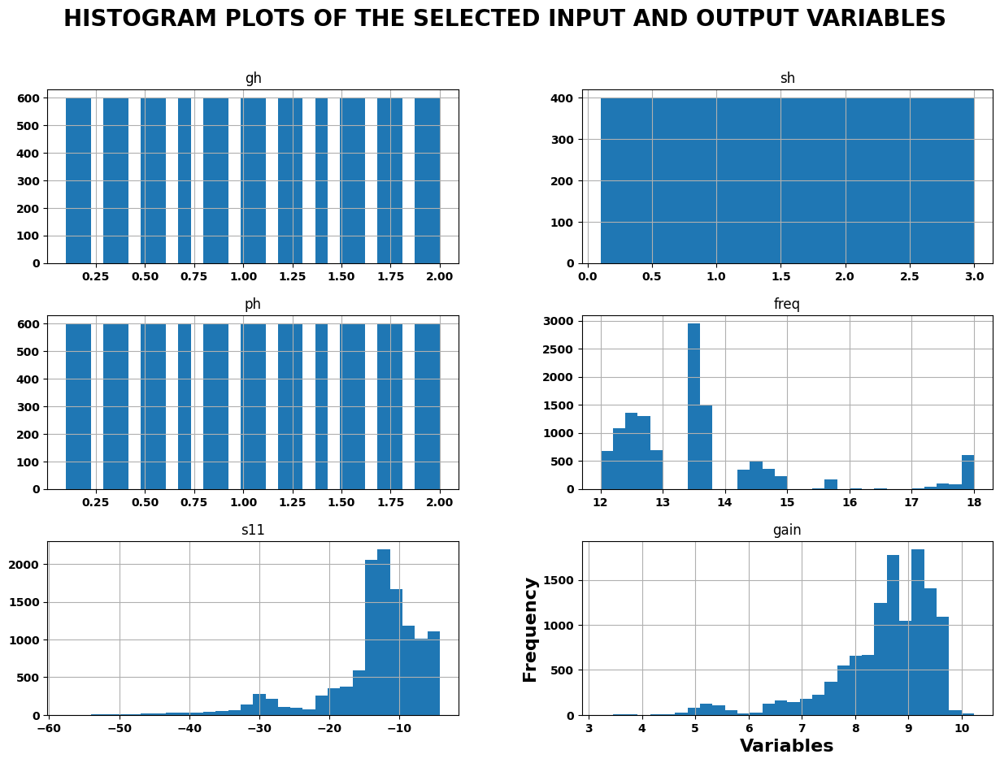

In [16]:
# CREATE FIGURE WITH SPECIFIED SIZE AND RESOLUTION
plt.figure(figsize=figsize, dpi=500)  

# PLOT HISTOGRAMS FOR SELECTED COLUMNS
df[selected_columns].hist(bins=30, figsize=figsize)  

# ADD TITLE AND AXIS LABELS WITH BOLD FONT
plt.suptitle('HISTOGRAM PLOTS OF THE SELECTED INPUT AND OUTPUT VARIABLES', fontsize=20, fontweight='bold')
plt.xlabel('Variables', fontsize=16, fontweight='bold')
plt.ylabel('Frequency', fontsize=16, fontweight='bold')

# MAKE AXIS TICK LABELS BOLD
for ax in plt.gcf().get_axes():
    for label in ax.get_xticklabels() + ax.get_yticklabels():
        label.set_fontweight('bold')

# SAVE FIGURE (COMMENTED OUT TO AVOID OVERWRITING)
# plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\Histogram.png', dpi=500)

# DISPLAY PLOT
plt.show()  

### CORRELATION MATRIX HEATMAP

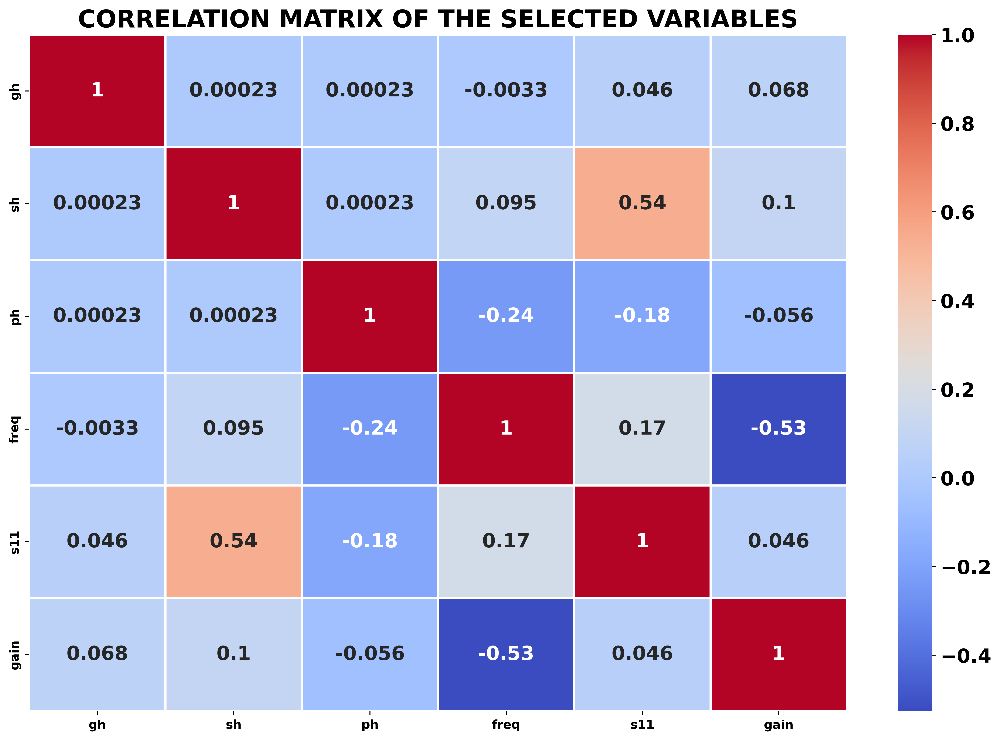

In [17]:
# COMPUTE CORRELATION MATRIX
corr_matrix = df[selected_columns].corr()  

# CREATE FIGURE WITH HIGH DPI FOR CLARITY
plt.figure(figsize=figsize, dpi=500)

# GENERATE HEATMAP
heatmap = sns.heatmap(
    corr_matrix, 
    annot=True,  # DISPLAY NUMERIC CORRELATION VALUES
    cmap='coolwarm',  # COLOR SCHEME
    linewidths=1.5,  # CELL BORDER WIDTH
    annot_kws={"size": 16, "weight": "bold"}  # ENLARGE AND BOLDEN TEXT
)

# ADD TITLE AND FORMAT AXES LABELS
plt.title('CORRELATION MATRIX OF THE SELECTED VARIABLES', fontsize=20, fontweight='bold')
plt.xticks(fontweight='bold')
plt.yticks(fontweight='bold')

# FORMAT COLORBAR TEXT SIZE AND WEIGHT
colorbar = heatmap.collections[0].colorbar
colorbar.ax.tick_params(labelsize=16)  # INCREASE FONT SIZE
for label in colorbar.ax.get_yticklabels():
    label.set_fontweight('bold')  # BOLDEN COLORBAR LABELS

# SAVE FIGURE (COMMENTED OUT)
# plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\CorrelationMatrix.png', dpi=500)

# DISPLAY PLOT
plt.show()

### IMPORTING MINMAXSCALER FOR FEATURE SCALING

In [20]:
# IMPORT MINMAXSCALER FOR FEATURE SCALING
from sklearn.preprocessing import MinMaxScaler

In [21]:
# FIT MINMAXSCALER ON FEATURE DATA
Scaler_X = MinMaxScaler().fit(X_train)  # COMPUTES SCALING PARAMETERS FOR FEATURES

# FIT MINMAXSCALER ON TARGET DATA
Scaler_Y = MinMaxScaler().fit(y_train)  # COMPUTES SCALING PARAMETERS FOR TARGETS

### TRANSFORMING DATA USING MINMAX SCALER

In [22]:
# APPLY MINMAX SCALING TO FEATURES
X_train_scaled = Scaler_X.transform(X_train)  # SCALE TRAINING FEATURES
X_test_scaled = Scaler_X.transform(X_test)  # SCALE TESTING FEATURES

# APPLY MINMAX SCALING TO TARGETS
y_train_scaled = Scaler_Y.transform(y_train)  # SCALE TRAINING TARGETS
y_test_scaled = Scaler_Y.transform(y_test)  # SCALE TESTING TARGETS

### BUILDING A NEURAL NETWORK MODEL WITH KERAS

**IMPORTING TENSORFLOW & KERAS MODULES**  
- `TENSORFLOW` - DEEP LEARNING FRAMEWORK.  
- `SEQUENTIAL` - LINEAR STACK OF LAYERS.  
- `DENSE` - FULLY CONNECTED LAYER.  
- `INPUT` - DEFINES INPUT SHAPE.  

**MODEL ARCHITECTURE**  
- **INPUT LAYER** - SHAPE MATCHES NUMBER OF FEATURES IN `X_TRAIN_SCALED`.  
- **HIDDEN LAYERS** -  
  - `27` NEURONS, RELU ACTIVATION.  
  - `81` NEURONS, RELU ACTIVATION.  
  - `486` NEURONS, RELU ACTIVATION (LARGER HIDDEN LAYER).  
  - `81` NEURONS, RELU ACTIVATION.  
- **OUTPUT LAYER** -  
  - `3` NEURONS (MATCHES NUMBER OF TARGET VARIABLES).  
  - `LINEAR` ACTIVATION FOR REGRESSION OUTPUT.  

**COMPILATION**  
- **LOSS FUNCTION** - `MEAN_SQUARED_ERROR` (MSE) FOR REGRESSION TASKS.  
- **OPTIMIZER** - `ADAM` FOR ADAPTIVE LEARNING.  
- **METRICS** - TRACKS MAE, MSE, ACCURACY, AND R2 SCORE.  
- **JIT_COMPILE='AUTO'** - ENABLES JUST-IN-TIME COMPILATION FOR PERFORMANCE OPTIMIZATION.  

**MODEL SUMMARY**  
- DISPLAYS LAYER CONFIGURATION, PARAMETERS, AND OUTPUT SHAPES.

In [ ]:
# IMPORT REQUIRED MODULES
import tensorflow as tf  # DEEP LEARNING FRAMEWORK
from keras.models import Sequential  # SEQUENTIAL MODEL TYPE
from keras.layers import Dense, Input  # DENSE LAYERS AND INPUT LAYER

# INITIALIZE SEQUENTIAL MODEL
model = Sequential()

# ADD INPUT LAYER
model.add(Input(shape=(X_train_scaled.shape[1],)))  # INPUT SHAPE MATCHES FEATURE COUNT

# ADD HIDDEN LAYERS
model.add(Dense(27, activation='relu'))  # FIRST HIDDEN LAYER WITH 27 NEURONS
model.add(Dense(81, activation='relu'))  # SECOND HIDDEN LAYER WITH 81 NEURONS
model.add(Dense(486, activation='relu'))  # THIRD HIDDEN LAYER WITH 486 NEURONS
model.add(Dense(81, activation='relu'))  # FOURTH HIDDEN LAYER WITH 81 NEURONS

# ADD OUTPUT LAYER
model.add(Dense(3, activation='linear'))  # OUTPUT LAYER WITH 3 NEURONS (REGRESSION)

# COMPILE MODEL
model.compile(
    loss='mean_squared_error',  # MSE LOSS FUNCTION
    optimizer='adam',  # ADAPTIVE OPTIMIZATION
    metrics=['mae', 'mse', 'accuracy', 'r2_score'],  # TRACK MULTIPLE METRICS
    jit_compile='auto'  # AUTOMATIC JUST-IN-TIME COMPILATION
)

# DISPLAY MODEL SUMMARY
model.summary()  

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_5 (Dense)                 │ (None, 27)             │           108 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 81)             │         2,268 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 486)            │        39,852 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 81)             │        39,447 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 3)              │           246 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 81,921 (320.00 KB)

 Trainable params: 81,921 (320.00 KB)

 Non-trainable params: 0 (0.00 B)

### TRAINING THE NEURAL NETWORK

In [ ]:
# DEFINE NUMBER OF TRAINING EPOCHS
EPOCHS = 5000  

# TRAIN THE MODEL
history = model.fit(
    X_train_scaled, y_train_scaled,  # INPUT AND TARGET DATA
    validation_split=0.2,  # RESERVE 20% OF TRAIN DATA FOR VALIDATION
    epochs=EPOCHS  # NUMBER OF TRAINING CYCLES
)

Epoch 1/5000
225/225 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.6234 - loss: 0.0700 - mae: 0.1861 - mse: 0.0700 - r2_score: -2.0259 - val_accuracy: 0.7989 - val_loss: 0.0139 - val_mae: 0.0735 - val_mse: 0.0139 - val_r2_score: 0.5695
Epoch 2/5000
225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7953 - loss: 0.0120 - mae: 0.0690 - mse: 0.0120 - r2_score: 0.5913 - val_accuracy: 0.7300 - val_loss: 0.0124 - val_mae: 0.0681 - val_mse: 0.0124 - val_r2_score: 0.6280
Epoch 3/5000
225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8175 - loss: 0.0113 - mae: 0.0636 - mse: 0.0113 - r2_score: 0.6453 - val_accuracy: 0.7656 - val_loss: 0.0121 - val_mae: 0.0609 - val_mse: 0.0121 - val_r2_score: 0.6562
Epoch 4/5000
225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8296 - loss: 0.0099 - mae: 0.0563 - mse: 0.0099 - r2_score: 0.6916 - val_accuracy: 0.8283 - val_loss: 0.0103 - val_mae: 0.0529 - val_mse: 0.0103 - val_r2_score: 0.7149
Epoch 5/5000
225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step -

In [ ]:
# RETRIEVE TRAINED MODEL METRICS, RETURNS FINAL TRAINING METRICS
model.get_metrics_result()  

{'accuracy': 0.9683333039283752,
 'loss': 0.0030908884946256876,
 'mae': 0.015058464370667934,
 'mse': 0.0030908884946256876,
 'r2_score': 0.9330658912658691}

### MODEL PERFORMANCE EVALUATION & PREDICTION PLOT

- `R2_SCORE`, `MEAN_ABSOLUTE_ERROR`, `MEAN_SQUARED_ERROR`, `EXPLAINED_VARIANCE_SCORE` - METRICS FOR EVALUATING REGRESSION PERFORMANCE.  
- `PREDICTIONERRORDISPLAY` - VISUALIZES MODEL PREDICTION PERFORMANCE.  
- `PLT.RCPARAMS.UPDATE({'FONT.SIZE': 16})` - SETS GLOBAL FONT SIZE FOR PLOTS.

### **FUNCTION: PLOT_PREDICTIONS()**
- PREDICTS OUTPUT USING TRAINED MODEL.  
- PLOTS ACTUAL VS. PREDICTED VALUES FOR VISUAL PERFORMANCE ANALYSIS.  
- FORMATS TICKS, GRID, AND LEGEND FOR CLARITY.  
- INCLUDES A **PERFECT PREDICTION LINE (Y=X)** FOR REFERENCE.

### **METRICS CALCULATION**
- **`R² SCORE`** - MEASURES HOW WELL THE MODEL FITS THE DATA (1 = PERFECT FIT).  
- **`MAE (MEAN ABSOLUTE ERROR)`** - AVERAGE ABSOLUTE DIFFERENCE BETWEEN ACTUAL & PREDICTED VALUES.  
- **`MSE (MEAN SQUARED ERROR)`** - AVERAGES THE SQUARED DIFFERENCES (PENALIZES LARGE ERRORS).  
- **`EXPLAINED VARIANCE SCORE`** - QUANTIFIES VARIABILITY EXPLAINED BY THE MODEL.

### **EXPECTED OUTPUT**
- VISUAL COMPARISON OF ACTUAL VS. PREDICTED VALUES.  
- NUMERICAL EVALUATION OF MODEL PERFORMANCE.  


46/94 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 

94/94 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


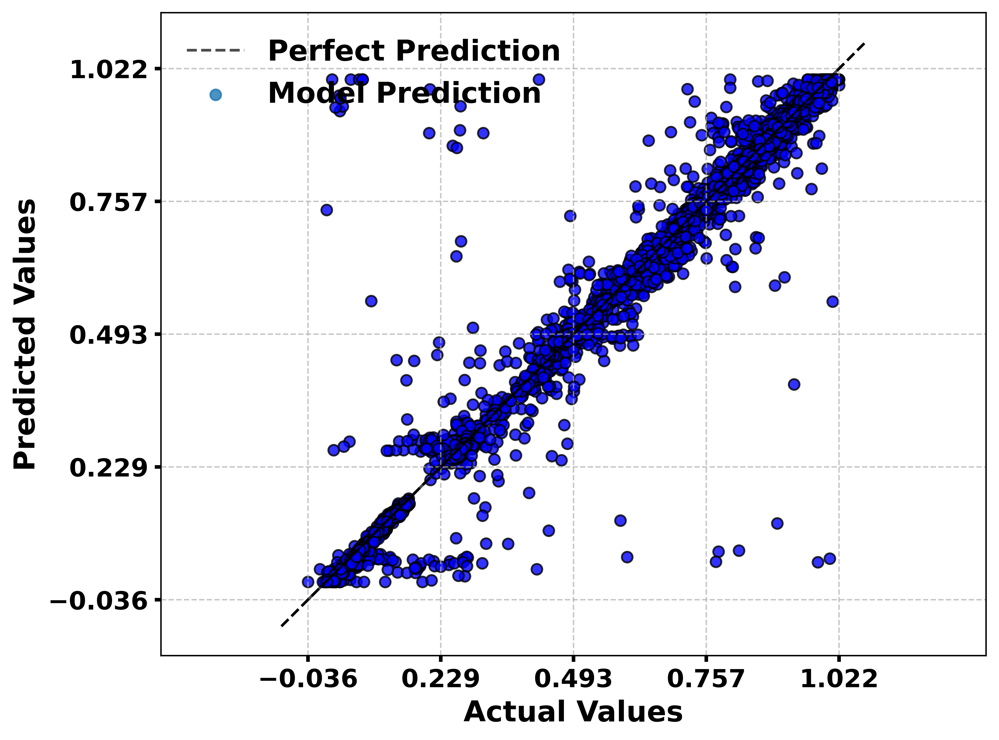

R² Score: 0.9342
Mean Absolute Error (MAE): 0.0144
Mean Squared Error (MSE): 0.0027
Explained Variance Score: 0.9346


In [ ]:
# IMPORT NECESSARY LIBRARIES
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, explained_variance_score
from sklearn.metrics import PredictionErrorDisplay

# SET FONT SIZE FOR PLOTS
plt.rcParams.update({'font.size': 16})

# FUNCTION TO PLOT ACTUAL VS. PREDICTED VALUES
def plot_predictions(model, X_test_scaled, y_test_scaled):
    predicted = model.predict(X_test_scaled)  # PREDICT OUTPUT

    # CREATE PREDICTION ERROR DISPLAY
    display = PredictionErrorDisplay(y_true=y_test_scaled, y_pred=predicted)
    fig, ax = plt.subplots(figsize=(8, 6), dpi=500)
    display.plot(kind="actual_vs_predicted", ax=ax)

    # LABEL AXES
    ax.set_xlabel("Actual Values", fontsize=16, fontweight='bold')
    ax.set_ylabel("Predicted Values", fontsize=16, fontweight='bold')

    # FORMAT AXES TICKS
    ax.tick_params(axis='both', which='major', labelsize=14, width=2)
    for label in ax.get_xticklabels() + ax.get_yticklabels():
        label.set_fontweight('bold')

    # ADD GRID & PERFECT PREDICTION LINE
    ax.grid(True, linestyle='--', alpha=0.7)
    ax.plot(ax.get_xlim(), ax.get_ylim(), ls="--", c="black")  # REFERENCE LINE Y=X

    # FORMAT LEGEND
    legend = ax.legend(['Perfect Prediction', 'Model Prediction'], loc='upper left', fontsize=16, frameon=False)
    for text in legend.get_texts():
        text.set_fontweight('bold')

    # ADJUST COLORS FOR VISUAL CLARITY
    ax.lines[0].set_color('black')  # PERFECT PREDICTION LINE
    ax.collections[0].set_edgecolor('black')
    ax.collections[0].set_facecolor('blue')

    # ENSURE PROPER LAYOUT & SHOW PLOT
    plt.tight_layout()
    # plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\NeuralNetwork.png', dpi=500)
    plt.show()

    return predicted

# PREDICT VALUES AND PLOT RESULTS
predicted = plot_predictions(model, X_test_scaled, y_test_scaled)

# CALCULATE METRICS
r2 = r2_score(y_test_scaled, predicted)  # R² SCORE
mae = mean_absolute_error(y_test_scaled, predicted)  # MEAN ABSOLUTE ERROR
mse = mean_squared_error(y_test_scaled, predicted)  # MEAN SQUARED ERROR
explained_variance = explained_variance_score(y_test_scaled, predicted)  # EXPLAINED VARIANCE SCORE

# PRINT PERFORMANCE METRICS
print(f"\033[1mR² Score:\033[0m {r2:.4f}")
print(f"\033[1mMean Absolute Error (MAE):\033[0m {mae:.4f}")
print(f"\033[1mMean Squared Error (MSE):\033[0m {mse:.4f}")
print(f"\033[1mExplained Variance Score:\033[0m {explained_variance:.4f}")

### EXTRACTING TRAINING HISTORY METRICS

In [ ]:
# EXTRACT ACCURACY METRICS 
accuracy = history.history['accuracy']  # TRAINING ACCURACY
val_accuracy = history.history['val_accuracy']  # VALIDATION ACCURACY

# EXTRACT LOSS METRICS
loss = history.history['loss']  # TRAINING LOSS
val_loss = history.history['val_loss']  # VALIDATION LOSS

# EXTRACT MEAN ABSOLUTE ERROR METRICS
mae = history.history['mae']  # TRAINING MAE
val_mae = history.history['val_mae']  # VALIDATION MAE

# EXTRACT MEAN SQUARED ERROR METRICS
mse = history.history['mse']  # TRAINING MSE
val_mse = history.history['val_mse']  # VALIDATION MSE

### PLOTTING TRAINING AND VALIDATION ACCURACY

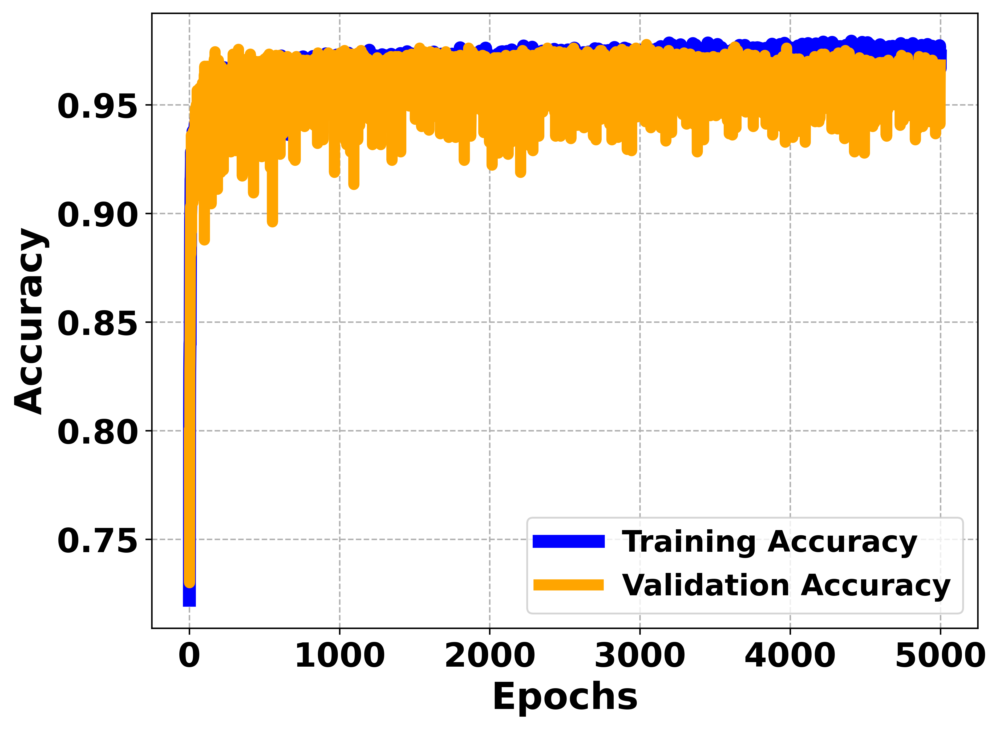

In [ ]:
# CREATE FIGURE WITH HIGH DPI
plt.figure(figsize=(8, 6), dpi=500)

# PLOT TRAINING AND VALIDATION ACCURACY
plt.plot(accuracy, label='Training Accuracy', color='blue', linewidth=7, alpha=1)
plt.plot(val_accuracy, label='Validation Accuracy', color='orange', linewidth=6, alpha=1)

# ADD AXIS LABELS WITH BOLD FORMATTING
plt.xlabel('Epochs', fontsize=20, fontweight='bold')
plt.ylabel('Accuracy', fontsize=20, fontweight='bold')

# FORMAT TICKS
plt.xticks(fontsize=18, fontweight='bold')
plt.yticks(fontsize=18, fontweight='bold')

# ADD LEGEND WITH BOLD TEXT
plt.legend(fontsize=18, prop={'weight': 'bold'})

# ENABLE GRID FOR CLARITY
plt.grid(True, linestyle='--', alpha=1)

# SAVE PLOT (COMMENTED OUT TO AVOID OVERWRITING)
# plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\Accuracy.png', dpi=500)

# DISPLAY PLOT
plt.show()

### PLOTTING TRAINING AND VALIDATION LOSS

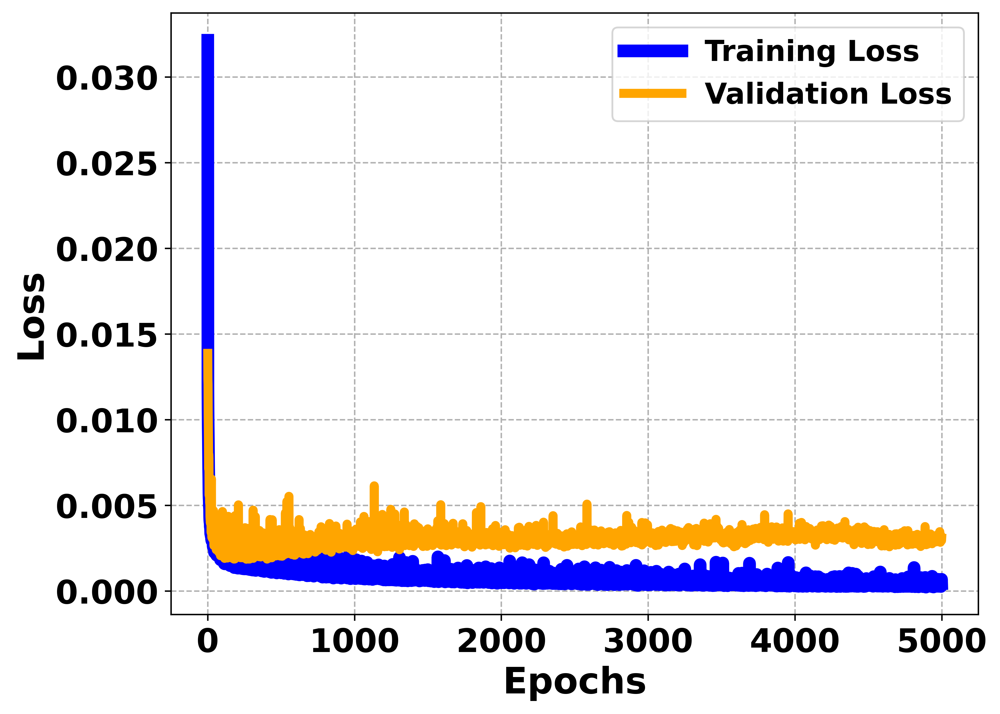

In [ ]:
# CREATE HIGH-RESOLUTION FIGURE
plt.figure(figsize=(8, 6), dpi=500)

# PLOT TRAINING AND VALIDATION LOSS
plt.plot(loss, label='Training Loss', color='blue', linewidth=7, alpha=1)
plt.plot(val_loss, label='Validation Loss', color='orange', linewidth=5, alpha=1)

# ADD AXIS LABELS WITH BOLD TEXT
plt.xlabel('Epochs', fontsize=20, fontweight='bold')
plt.ylabel('Loss', fontsize=20, fontweight='bold')

# FORMAT TICKS
plt.xticks(fontsize=18, fontweight='bold')
plt.yticks(fontsize=18, fontweight='bold')

# ADD LEGEND WITH BOLD TEXT
plt.legend(fontsize=18, prop={'weight': 'bold'})

# ENABLE GRID FOR BETTER VISUAL CLARITY
plt.grid(True, linestyle='--', alpha=1)

# SAVE PLOT (COMMENTED OUT TO PREVENT OVERWRITING)
# plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\Loss.png', dpi=500)

# DISPLAY PLOT
plt.show()

### PLOTTING TRAINING AND VALIDATION MAE (MEAN ABSOLUTE ERROR)

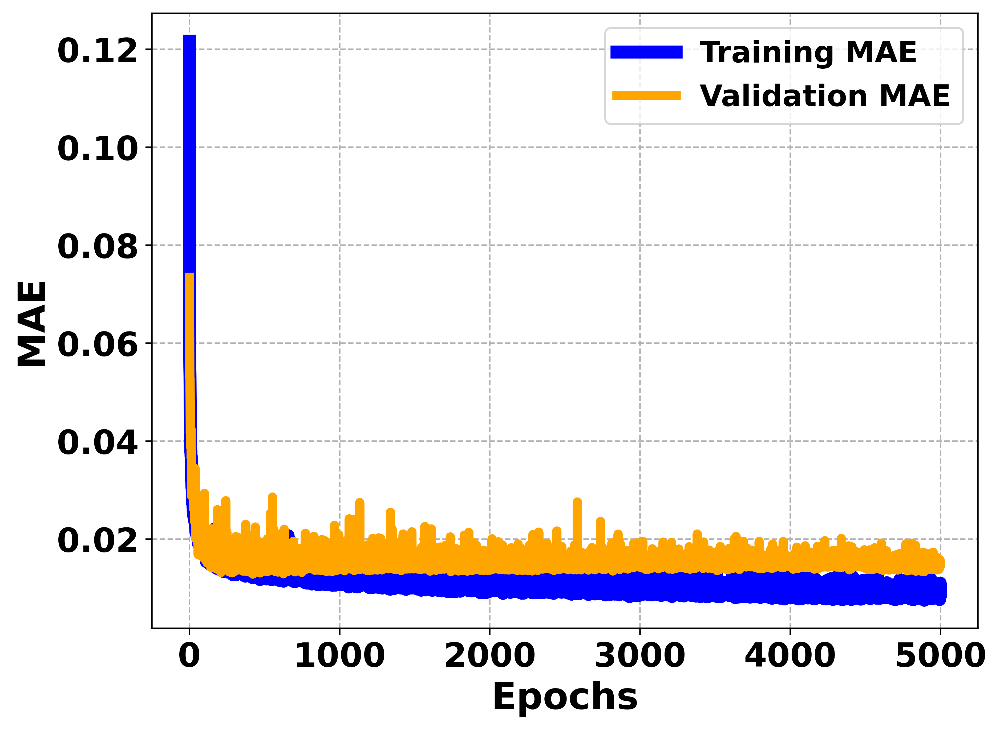

In [ ]:
# CREATE HIGH-RESOLUTION FIGURE
plt.figure(figsize=(8, 6), dpi=500)

# PLOT TRAINING AND VALIDATION MAE
plt.plot(mae, label='Training MAE', color='blue', linewidth=7, alpha=1)
plt.plot(val_mae, label='Validation MAE', color='orange', linewidth=5, alpha=1)

# ADD AXIS LABELS WITH BOLD TEXT
plt.xlabel('Epochs', fontsize=20, fontweight='bold')
plt.ylabel('MAE', fontsize=20, fontweight='bold')

# FORMAT TICKS
plt.xticks(fontsize=18, fontweight='bold')
plt.yticks(fontsize=18, fontweight='bold')

# ADD LEGEND WITH BOLD TEXT
plt.legend(fontsize=18, prop={'weight': 'bold'})

# ENABLE GRID FOR BETTER VISUAL CLARITY
plt.grid(True, linestyle='--', alpha=1)

# SAVE PLOT (COMMENTED OUT TO PREVENT OVERWRITING)
# plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\MAE.png', dpi=500)

# DISPLAY PLOT
plt.show()

### PLOTTING TRAINING AND VALIDATION MSE (MEAN SQUARED ERROR)

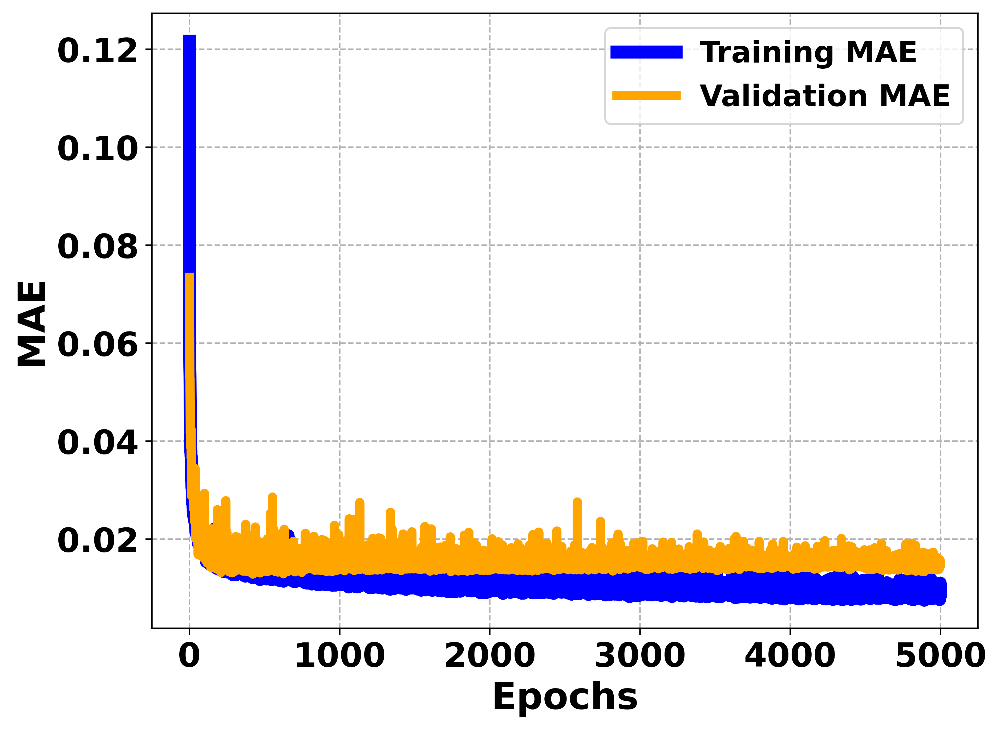

In [ ]:
# CREATE HIGH-RESOLUTION FIGURE
plt.figure(figsize=(8, 6), dpi=500)

# PLOT TRAINING AND VALIDATION MSE
plt.plot(mse, label='Training MSE', color='blue', linewidth=7, alpha=1)
plt.plot(val_mse, label='Validation MSE', color='orange', linewidth=5, alpha=1)

# LABEL AXES WITH BOLD FONT
plt.xlabel('Epochs', fontsize=20, fontweight='bold')
plt.ylabel('MSE', fontsize=20, fontweight='bold')

# FORMAT TICKS
plt.xticks(fontsize=18, fontweight='bold')
plt.yticks(fontsize=18, fontweight='bold')

# ADD LEGEND WITH BOLD TEXT
plt.legend(fontsize=18, prop={'weight': 'bold'})

# ENABLE GRID FOR VISUAL CLARITY
plt.grid(True, linestyle='--', alpha=1)

# SAVE PLOT (COMMENTED OUT TO PREVENT OVERWRITING)
# plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\MSE.png', dpi=500)

# DISPLAY PLOT
plt.show()

# SK-LEARN

### FUNCTION TO EVALUATE MODEL PERFORMANCE & VISUALIZE PREDICTIONS

In [23]:
# IMPORT REQUIRED LIBRARIES
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, explained_variance_score
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 16})  # SET GLOBAL FONT SIZE
from sklearn.metrics import PredictionErrorDisplay

# FUNCTION TO PRINT METRICS AND DISPLAY PREDICTION ERROR PLOT
def print_metrics(fname, bar, model, x_test_scaled, y_test):
    predicted = model.predict(x_test_scaled)  # PREDICT OUTPUT

    # PRINT HEADER
    print(f'\n{bar}\n' + '-' * len(bar))

    # CREATE PREDICTION ERROR DISPLAY
    display = PredictionErrorDisplay(y_true=y_test, y_pred=predicted)
    
    fig, ax = plt.subplots(figsize=(8, 6), dpi=500)
    display.plot(kind="actual_vs_predicted", ax=ax)

    # LABEL AXES
    ax.set_xlabel("Actual Values", fontsize=16, fontweight='bold')
    ax.set_ylabel("Predicted Values", fontsize=16, fontweight='bold')

    # FORMAT AXIS TICKS
    ax.tick_params(axis='both', which='major', labelsize=14, width=2)
    for label in ax.get_xticklabels() + ax.get_yticklabels():
        label.set_fontweight('bold')

    # ADD GRID AND PERFECT PREDICTION LINE
    ax.grid(True, linestyle='--', alpha=0.7)
    ax.plot(ax.get_xlim(), ax.get_ylim(), ls="--", c="black")  # REFERENCE LINE Y=X

    # FORMAT LEGEND
    legend = ax.legend(['Perfect Prediction', 'Model Prediction'], loc='upper left', fontsize=16, frameon=False)
    for text in legend.get_texts():
        text.set_fontweight('bold')

    # ADJUST COLORS FOR VISUAL CLARITY
    ax.lines[0].set_color('black')  # PERFECT PREDICTION LINE
    ax.collections[0].set_edgecolor('black')
    ax.collections[0].set_facecolor('blue')

    # ENSURE PROPER LAYOUT & SHOW PLOT
    plt.tight_layout()
    # plt.savefig(r"C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\{}.png".format(fname), dpi=500)  # SAVE PLOT (COMMENTED OUT)
    plt.show()

    # PRINT PERFORMANCE METRICS
    print(f"\033[1mR² Score:\033[0m {r2_score(y_test, predicted):.4f}")
    print(f"\033[1mMean Absolute Error (MAE):\033[0m {mean_absolute_error(y_test, predicted):.4f}")
    print(f"\033[1mMean Squared Error (MSE):\033[0m {mean_squared_error(y_test, predicted):.4f}")
    print(f"\033[1mExplained Variance Score:\033[0m {explained_variance_score(y_test, predicted):.4f}")
    print()

 ### BASELINE MODEL: DUMMY REGRESSOR

**PURPOSE:**  
- CREATES A SIMPLE BASELINE MODEL USING `DUMMYREGRESSOR`.  
- COMPARES THE PERFORMANCE OF THE ACTUAL MODEL AGAINST A BASIC MEAN-BASED PREDICTION.

**DUMMY REGRESSOR STRATEGY:**
- **`STRATEGY="MEAN"`** - ALWAYS PREDICTS THE MEAN OF THE TRAINING TARGETS.  
- SERVES AS A **REFERENCE POINT** TO MEASURE THE EFFECTIVENESS OF THE ACTUAL MODEL.


DUMMY REGRESSOR
---------------


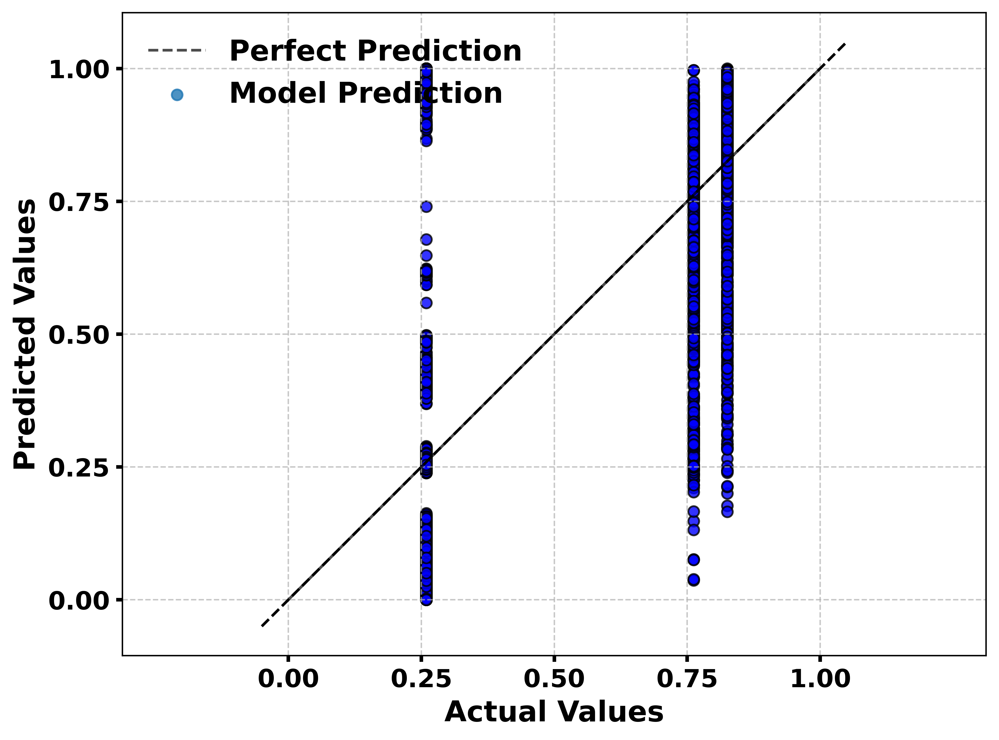

R² Score: -0.0007
Mean Absolute Error (MAE): 0.1156
Mean Squared Error (MSE): 0.0313
Explained Variance Score: 0.0000



In [24]:
# IMPORT DUMMY REGRESSOR FOR BASELINE MODEL
from sklearn.dummy import DummyRegressor

# INITIALIZE DUMMY REGRESSOR WITH MEAN STRATEGY
dummy_reg = DummyRegressor(strategy="mean")

# TRAIN THE DUMMY REGRESSOR
dummy_reg.fit(X_train_scaled, y_train_scaled)

# EVALUATE BASELINE MODEL PERFORMANCE
print_metrics("DummyRegressor", "DUMMY REGRESSOR", dummy_reg, X_test_scaled, y_test_scaled)

### IMPORTING LINEAR MODELS FROM SCIKIT-LEARN

**PURPOSE:**  
- `SKLEARN.LINEAR_MODEL` CONTAINS VARIOUS LINEAR REGRESSION MODELS FOR MACHINE LEARNING.  
- USED FOR REGRESSION TASKS WHERE OUTPUT IS A CONTINUOUS VARIABLE.

In [ ]:
# IMPORT LINEAR MODELS FROM SCIKIT-LEARN
from sklearn import linear_model  

### LINEAR REGRESSION MODEL

**PURPOSE:**  
- IMPLEMENTING A SIMPLE LINEAR REGRESSION MODEL USING `LINEARREGRESSION()` FROM `SKLEARN`.  
- COMPARES THE PERFORMANCE OF THE LINEAR MODEL WITH OTHER MODELS.


LINEAR REGRESSION
-----------------


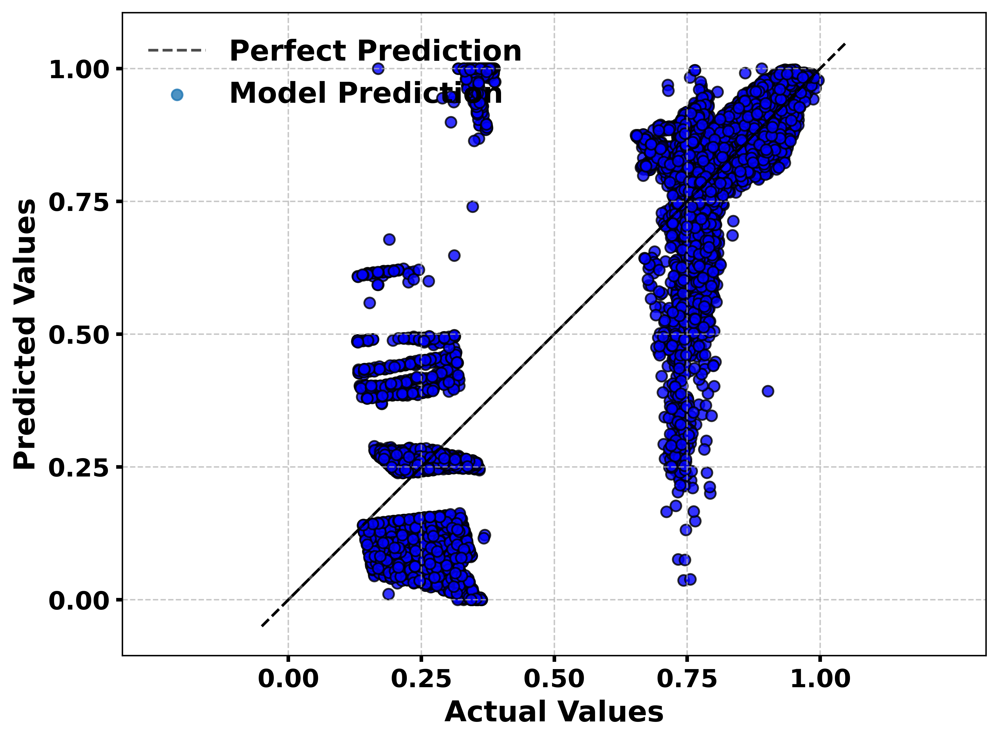

R² Score: 0.1366
Mean Absolute Error (MAE): 0.1160
Mean Squared Error (MSE): 0.0281
Explained Variance Score: 0.1374



In [28]:
# INITIALIZE LINEAR REGRESSION MODEL
linear = linear_model.LinearRegression()

# TRAIN THE LINEAR REGRESSION MODEL
linear.fit(X_train_scaled, y_train_scaled)

# EVALUATE THE LINEAR MODEL PERFORMANCE
print_metrics("LinearRegression", "LINEAR REGRESSION", linear, X_test_scaled, y_test_scaled)

### RIDGE REGRESSION MODEL

**PURPOSE:**  
- IMPLEMENTING RIDGE REGRESSION USING `RIDGE()` FROM `SKLEARN.LINEAR_MODEL`.  
- RIDGE REGRESSION ADDITIONALLY USES L2 REGULARIZATION (RIDGE PENALTY) TO REDUCE MODEL COMPLEXITY AND PREVENT OVERFITTING.


RIDGE REGRESSION
----------------


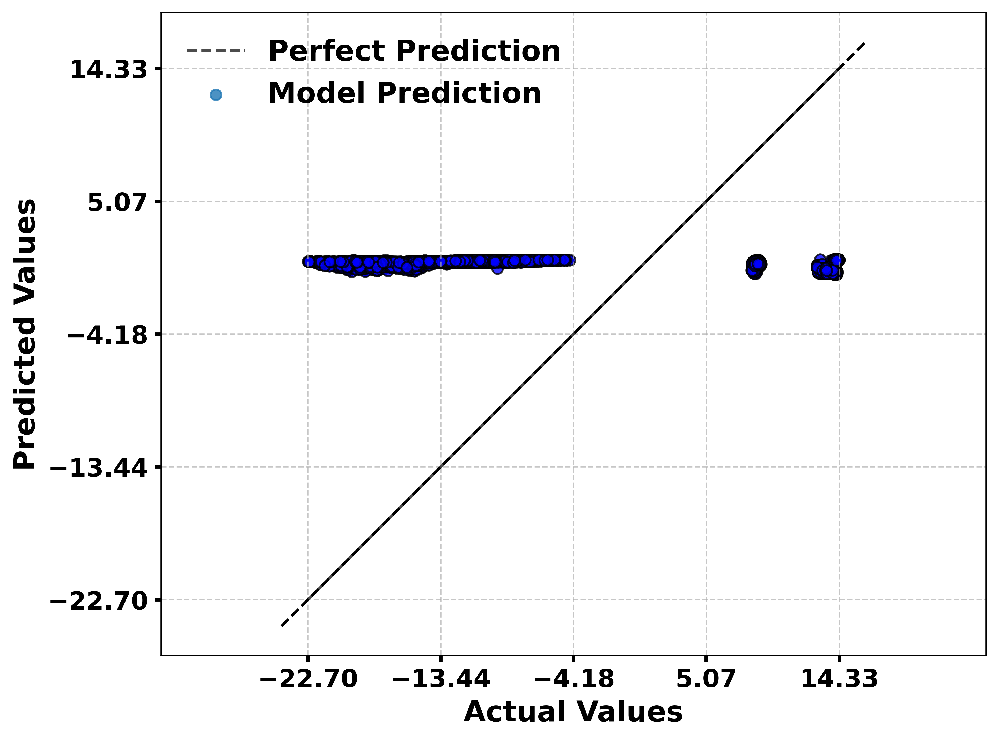

R² Score: -6525.5321
Mean Absolute Error (MAE): 11.8235
Mean Squared Error (MSE): 153.6084
Explained Variance Score: -330.8196



In [29]:
# INITIALIZE RIDGE REGRESSION MODEL WITH ALPHA = 0.5
ridge_reg = linear_model.Ridge(alpha=.5)

# TRAIN THE RIDGE REGRESSION MODEL
ridge_reg.fit(X_train_scaled, y_train)

# EVALUATE RIDGE REGRESSION PERFORMANCE
print_metrics("Ridge", "RIDGE REGRESSION", ridge_reg, X_test_scaled, y_test_scaled)

### MULTI-OUTPUT BAYESIAN RIDGE REGRESSION

**PURPOSE:**  
- IMPLEMENTING **MULTI-OUTPUT REGRESSION** USING `MULTIOUTPUTREGRESSOR()` WITH **BAYESIAN RIDGE REGRESSION** AS THE BASE REGRESSOR.  
- PREDICTS MULTIPLE TARGET VARIABLES SIMULTANEOUSLY WITH BAYESIAN RIDGE REGRESSION.


BAYESIAN RIDGE REGRESSION
-------------------------


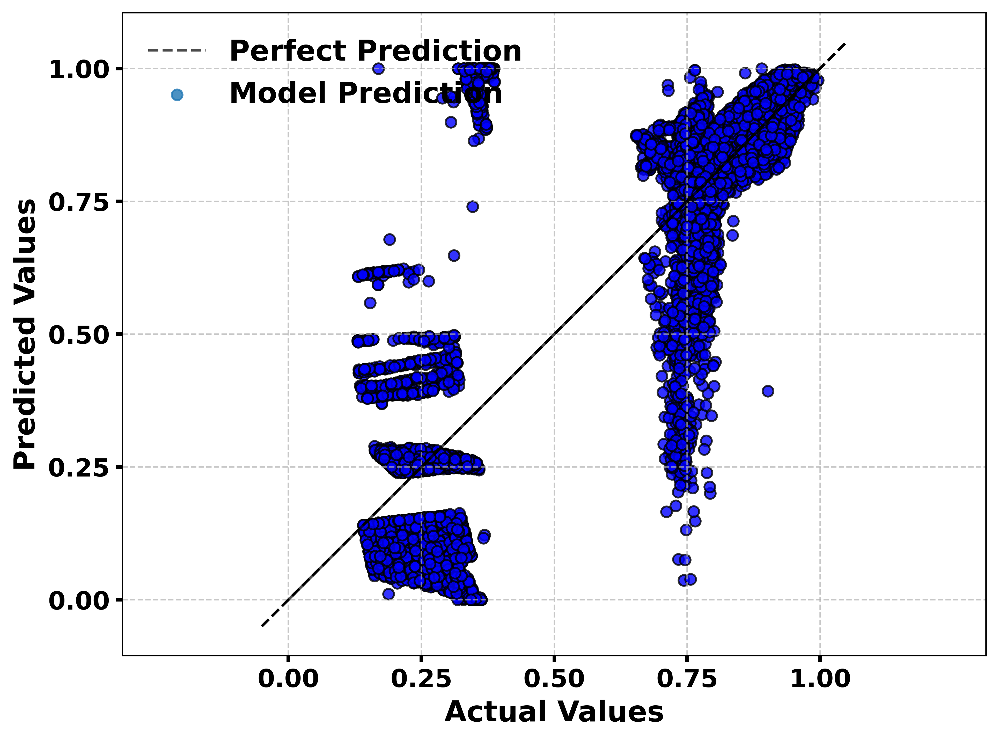

R² Score: 0.1365
Mean Absolute Error (MAE): 0.1160
Mean Squared Error (MSE): 0.0281
Explained Variance Score: 0.1374



In [32]:
from sklearn.multioutput import MultiOutputRegressor, RegressorChain

# INITIALIZE MULTI-OUTPUT REGRESSOR WITH BAYESIAN RIDGE REGRESSION
bayesian_redge_reg = MultiOutputRegressor(linear_model.BayesianRidge())

# FIT THE MODEL ON TRAINING DATA
bayesian_redge_reg.fit(X_train_scaled, y_train_scaled)

# EVALUATE PERFORMANCE OF THE BAYESIAN RIDGE REGRESSION MODEL
print_metrics("LassoLarsBayesianRidge", "BAYESIAN RIDGE REGRESSION", bayesian_redge_reg, X_test_scaled, y_test_scaled)

### POLYNOMIAL FEATURE TRANSFORMATION AND MODELING

### **PURPOSE:**  
- **POLYNOMIAL TRANSFORMATION** IS USED TO CREATE NON-LINEAR FEATURES FROM LINEAR ONES.  
- **HISTOGRAM GRADIENT BOOSTING REGRESSOR (HGBR)** AND **LINEAR REGRESSION** ARE APPLIED ON POLYNOMIAL FEATURES TO IMPROVE PREDICTIONS.

### **STEP 1: POLYNOMIAL FEATURES**
- **`POLYNOMIALFEATURES(4)`** - CREATES POLYNOMIAL FEATURES OF DEGREE 4 FROM THE ORIGINAL DATA.  
- **`FIT_TRANSFORM()`** - APPLIES POLYNOMIAL TRANSFORMATION ON TRAINING DATA.

### **STEP 2: HISTOGRAM GRADIENT BOOSTING REGRESSOR (HGBR)**
- **`HISTGRADIENTBOOSTINGREGRESSOR()`** - A GRADIENT BOOSTING MODEL THAT USES HISTOGRAMS FOR FASTER COMPUTATIONS.  
- **`MULTIOUTPUTREGRESSOR()`** - HANDLES MULTIPLE TARGET VARIABLES SIMULTANEOUSLY.

### **STEP 3: LINEAR REGRESSION WITH POLYNOMIAL FEATURES**
- **`LINEARREGRESSION()`** - PERFORMS LINEAR REGRESSION ON POLYNOMIAL FEATURES WITHOUT AN INTERCEPT.


HISTOGRAM GRADIENT BOOSTING REGRESSION MODEL
--------------------------------------------


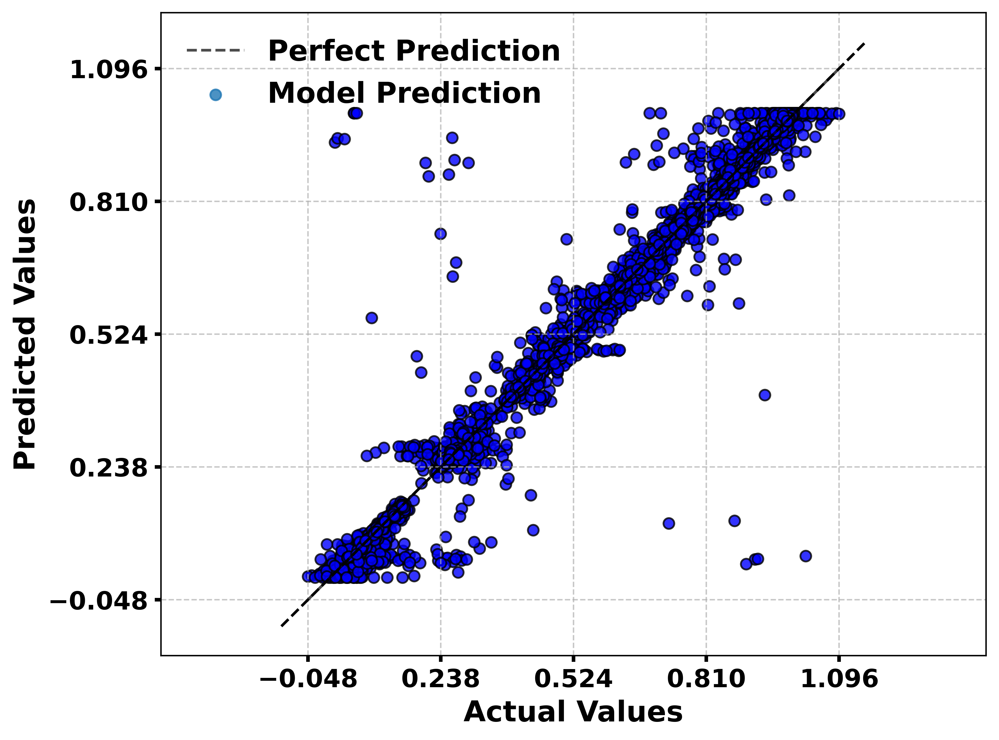

R² Score: 0.9510
Mean Absolute Error (MAE): 0.0129
Mean Squared Error (MSE): 0.0021
Explained Variance Score: 0.9510


LINEAR REGRESSION WITH POLYNOMIAL FEATURES
------------------------------------------


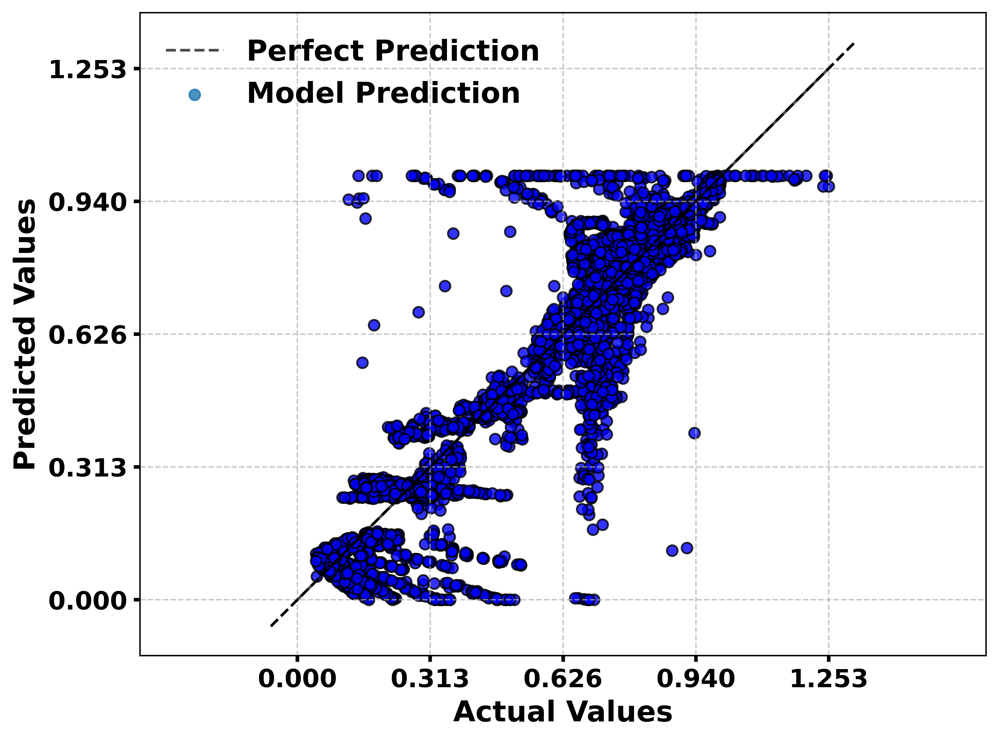

R² Score: 0.6693
Mean Absolute Error (MAE): 0.0590
Mean Squared Error (MSE): 0.0108
Explained Variance Score: 0.6695



In [33]:
# IMPORT NECESSARY MODULES
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.multioutput import MultiOutputRegressor

# CREATE POLYNOMIAL FEATURES OF DEGREE 4
poly = PolynomialFeatures(4)

# INITIALIZE HISTOGRAM GRADIENT BOOSTING REGRESSOR
hgbr_reg = MultiOutputRegressor(HistGradientBoostingRegressor(loss="squared_error", max_leaf_nodes=128))

# TRANSFORM TRAINING DATA WITH POLYNOMIAL FEATURES
X_train_poly = poly.fit_transform(X_train_scaled)

# FIT THE HISTOGRAM GRADIENT BOOSTING REGRESSOR
hgbr_reg.fit(X_train_poly, y_train_scaled)

# TRANSFORM TEST DATA WITH POLYNOMIAL FEATURES
X_test_poly = poly.transform(X_test_scaled)

# EVALUATE THE PERFORMANCE OF HGBR
print_metrics("HistRegression", "HISTOGRAM GRADIENT BOOSTING REGRESSION MODEL", hgbr_reg, X_test_poly, y_test_scaled)

# LINEAR REGRESSION WITH POLYNOMIAL FEATURES (WITHOUT INTERCEPT)
linear_poly = linear_model.LinearRegression(fit_intercept=False)

# FIT THE LINEAR REGRESSION MODEL ON POLYNOMIAL FEATURES
linear_poly.fit(X_train_poly, y_train_scaled)

# EVALUATE THE PERFORMANCE OF POLYNOMIAL LINEAR REGRESSION
print_metrics("PolynomialRegression", "LINEAR REGRESSION WITH POLYNOMIAL FEATURES", linear_poly, X_test_poly, y_test_scaled)

# SUPPORT VECTOR REGRESSION (SVM)

### RBF KERNEL

### **PURPOSE:**  
- **SUPPORT VECTOR REGRESSION (SVR)** IS A REGRESSION METHOD BASED ON SUPPORT VECTOR MACHINES (SVM).  
- **RBF KERNEL** IS USED TO HANDLE NON-LINEAR DATA BY MAPPING IT TO A HIGHER-DIMENSIONAL SPACE.

### **KEY PARAMETERS:**
- **`C=100`** - PENALTY PARAMETER CONTROLS THE TRADE-OFF BETWEEN SMOOTHNESS AND TRAINING ERROR.  
- **`GAMMA=0.1`** - CONTROLS THE INFLUENCE OF A SINGLE TRAINING EXAMPLE; SMALLER VALUES MEAN FARTHER REACH.  
- **`EPSILON=0.1`** - DEFINITION OF TOLERABLE ERROR MARGIN IN THE SVR MODEL.

### **MULTI-OUTPUT REGRESSION:**
- **`MULTIOUTPUTREGRESSOR()`** - HANDLES MULTIPLE TARGET VARIABLES SIMULTANEOUSLY.


SUPPORT VECTOR REGRESSION (SVM) WITH RBF KERNEL
-----------------------------------------------


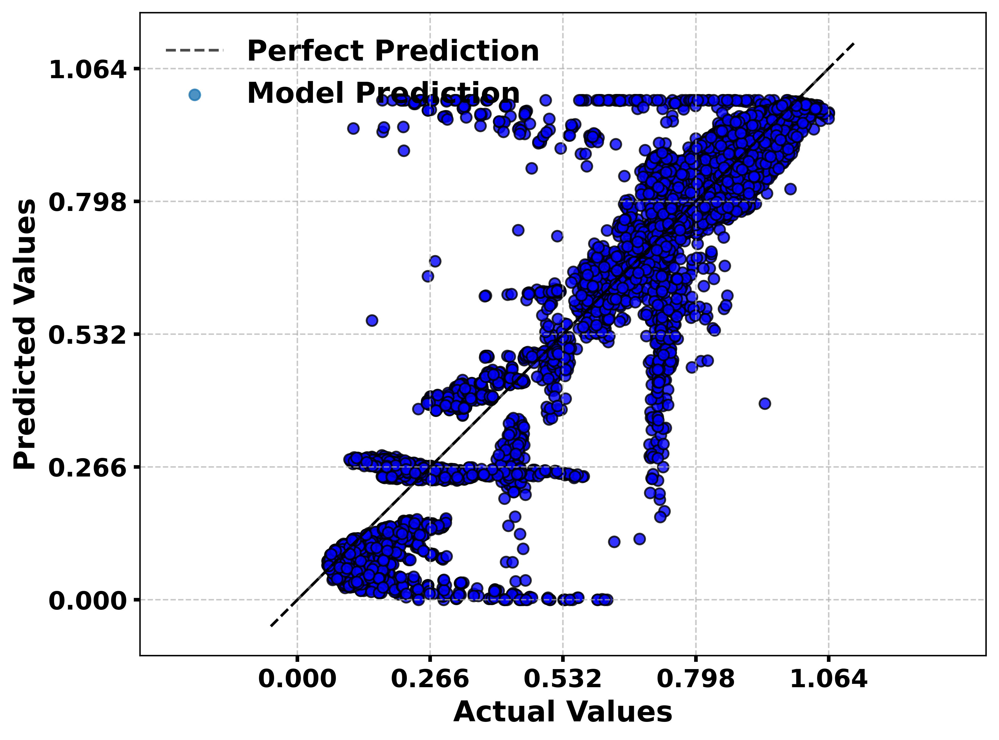

R² Score: 0.5482
Mean Absolute Error (MAE): 0.0781
Mean Squared Error (MSE): 0.0146
Explained Variance Score: 0.5541



In [34]:
# IMPORT SVM MODULE AND MULTI-OUTPUT REGRESSOR
from sklearn import svm
from sklearn.multioutput import MultiOutputRegressor

# INITIALIZE SUPPORT VECTOR REGRESSION WITH RBF KERNEL
svr_reg = MultiOutputRegressor(svm.SVR(kernel="rbf", C=100, gamma=0.1, epsilon=0.1))

# FIT THE SUPPORT VECTOR REGRESSION MODEL
svr_reg.fit(X_train_scaled, y_train_scaled)

# EVALUATE THE PERFORMANCE OF THE SVR MODEL
print_metrics("SVM[R]", "SUPPORT VECTOR REGRESSION (SVM) WITH RBF KERNEL", svr_reg, X_test_scaled, y_test_scaled)

### LINEAR KERNEL

### **PURPOSE:**  
- **SUPPORT VECTOR REGRESSION (SVR)** WITH A **LINEAR KERNEL** IS USED TO MODEL LINEAR RELATIONSHIPS BETWEEN FEATURES AND TARGET VARIABLES.

### **KEY PARAMETERS:**
- **`C=100`** - CONTROLS THE REGULARIZATION, TRADE-OFF BETWEEN MODEL COMPLEXITY AND ERROR.  
- **`GAMMA='auto'`** - SETS GAMMA TO 1/FEATURES, CONTROLLING THE INFLUENCE OF SINGLE TRAINING EXAMPLES (USEFUL IN LINEAR CASES).  
- **`KERNEL='linear'`** - USES A LINEAR KERNEL TO MAPPING DATA TO A HIGHER DIMENSIONAL SPACE.


SUPPORT VECTOR REGRESSION (SVM) WITH LINEAR KERNEL
--------------------------------------------------


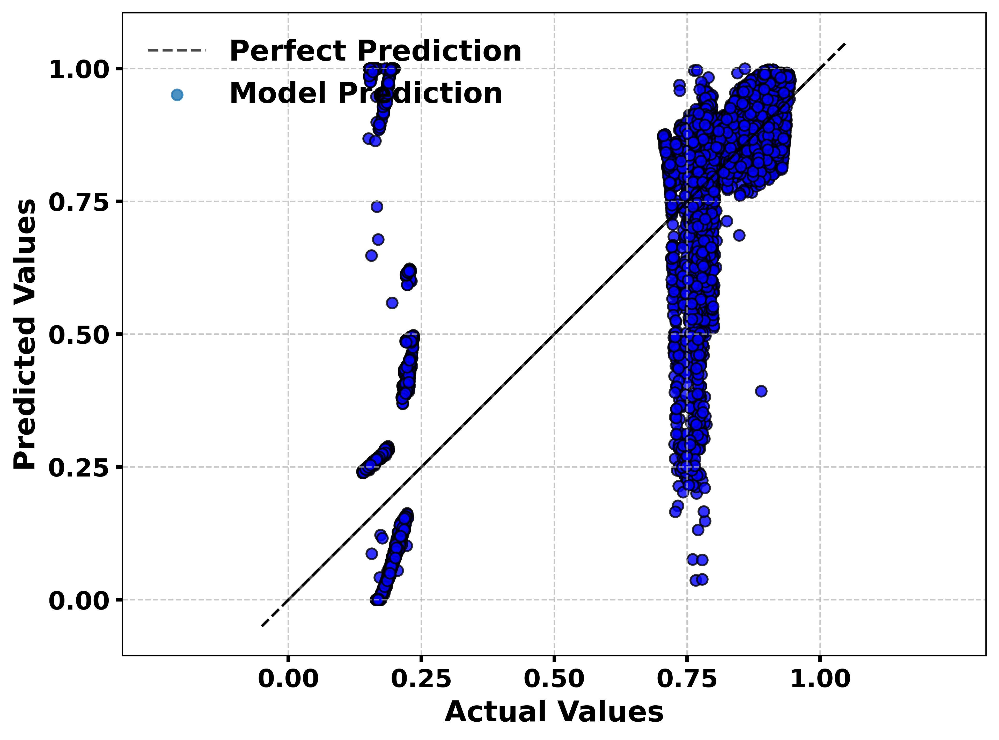

R² Score: 0.0587
Mean Absolute Error (MAE): 0.1192
Mean Squared Error (MSE): 0.0320
Explained Variance Score: 0.0968



In [ ]:
# INITIALIZE SUPPORT VECTOR REGRESSION WITH LINEAR KERNEL
svr_reg = MultiOutputRegressor(svm.SVR(kernel="linear", C=100, gamma="auto"))

# FIT THE SUPPORT VECTOR REGRESSION MODEL
svr_reg.fit(X_train_scaled, y_train_scaled)

# EVALUATE THE PERFORMANCE OF THE LINEAR KERNEL SVR MODEL
print_metrics("SVM[L]", "SUPPORT VECTOR REGRESSION (SVM) WITH LINEAR KERNEL", svr_reg, X_test_scaled, y_test_scaled)

### POLYNOMIAL KERNEL

### **PURPOSE:**  
- **SUPPORT VECTOR REGRESSION (SVR)** WITH A **POLYNOMIAL KERNEL** IS USED TO MODEL NON-LINEAR RELATIONSHIPS BETWEEN FEATURES AND TARGET VARIABLES.

### **KEY PARAMETERS:**
- **`C=100`** - REGULARIZATION PARAMETER THAT CONTROLS THE TRADE-OFF BETWEEN MAXIMIZING THE MARGIN AND MINIMIZING ERROR.  
- **`GAMMA='auto'`** - GAMMA SET TO 1/FEATURES, DEFINES THE INFLUENCE OF A SINGLE TRAINING EXAMPLE.  
- **`DEGREE=3`** - DEGREE OF THE POLYNOMIAL KERNEL.  
- **`EPSILON=0.1`** - TOLERANCE OF ERROR, DETERMINES HOW MUCH ERROR IS ALLOWED IN THE MODEL.  
- **`COEF0=1`** - CONSTANT THAT AFFECTS THE POLYNOMIAL KERNEL (INFLUENCE OF HIGHER-DIMENSIONAL SPACE).


SUPPORT VECTOR REGRESSION (SVM) WITH POLYNOMIAL KERNEL
------------------------------------------------------


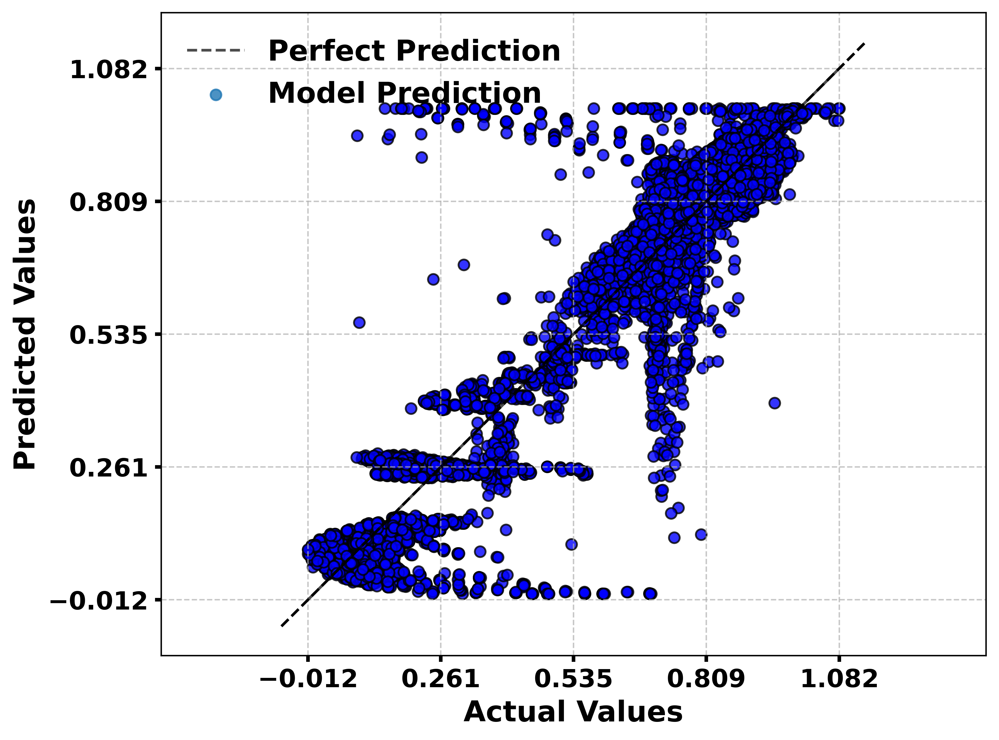

R² Score: 0.5724
Mean Absolute Error (MAE): 0.0747
Mean Squared Error (MSE): 0.0138
Explained Variance Score: 0.5744



In [37]:
# INITIALIZE SUPPORT VECTOR REGRESSION WITH POLYNOMIAL KERNEL
svr_reg = MultiOutputRegressor(svm.SVR(kernel="poly", C=100, gamma="auto", degree=3, epsilon=0.1, coef0=1))

# FIT THE SUPPORT VECTOR REGRESSION MODEL
svr_reg.fit(X_train_scaled, y_train_scaled)

# EVALUATE THE PERFORMANCE OF THE POLYNOMIAL KERNEL SVR MODEL
print_metrics("SVM[P]", "SUPPORT VECTOR REGRESSION (SVM) WITH POLYNOMIAL KERNEL", svr_reg, X_test_scaled, y_test_scaled)

### K-NEAREST NEIGHBORS (KNN) REGRESSION

### **PURPOSE:**  
- **K-NEAREST NEIGHBORS (KNN)** IS A NON-PARAMETRIC METHOD USED FOR REGRESSION BY PREDICTING A TARGET VARIABLE BASED ON THE K NEAREST TRAINING EXAMPLES.

### **KEY PARAMETERS:**
- **`n_neighbors=5`** - THE NUMBER OF NEAREST NEIGHBORS TO CONSIDER FOR PREDICTION.  
- **`weights="distance"`** - GIVES MORE WEIGHT TO CLOSER NEIGHBORS, IMPROVING THE REGRESSION ACCURACY.  
- **`KNN_REGRESSOR()`** - USED FOR PREDICTING THE CONTINUOUS TARGET VARIABLES BASED ON NEAREST NEIGHBORS.


K-NEAREST NEIGHBORS (KNN) REGRESSION
------------------------------------


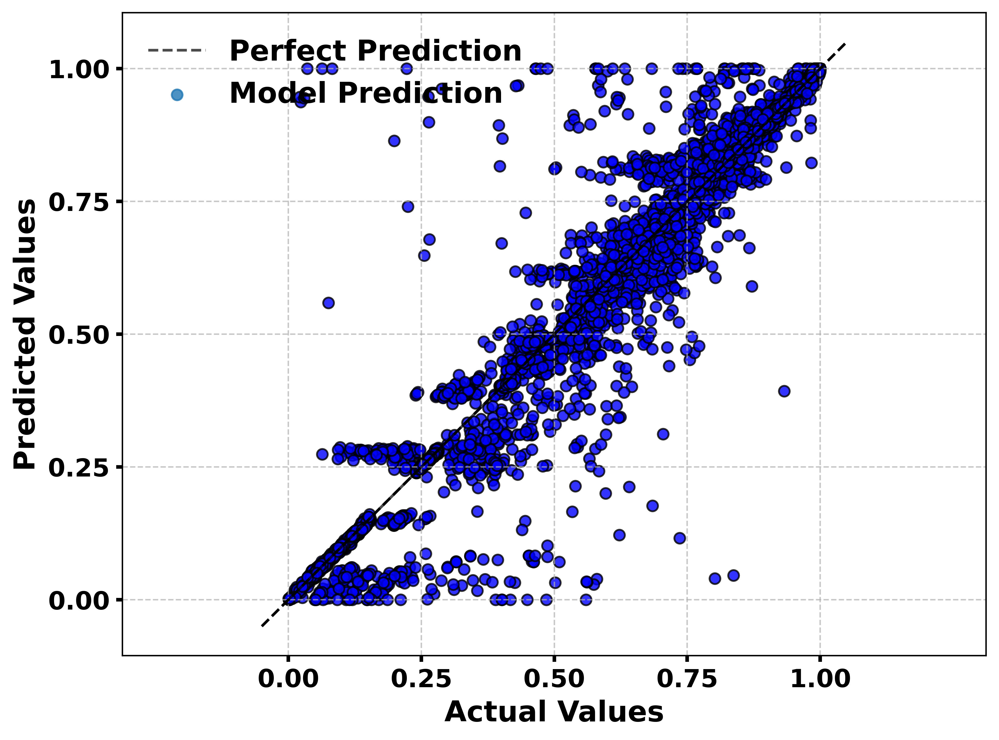

R² Score: 0.8669
Mean Absolute Error (MAE): 0.0256
Mean Squared Error (MSE): 0.0044
Explained Variance Score: 0.8672



In [40]:
# IMPORT K-NEAREST NEIGHBORS REGRESSOR
from sklearn import neighbors

# INITIALIZE K-NEAREST NEIGHBORS REGRESSOR WITH 5 NEIGHBORS AND WEIGHTING BY DISTANCE
n_neighbors = 5
knn_reg = neighbors.KNeighborsRegressor(n_neighbors, weights="distance")

# FIT THE KNN REGRESSION MODEL
knn_reg.fit(X_train_scaled, y_train_scaled)

# EVALUATE THE PERFORMANCE OF THE KNN MODEL
print_metrics("KNN", "K-NEAREST NEIGHBORS (KNN) REGRESSION", knn_reg, X_test_scaled, y_test_scaled)

### DECISION TREE REGRESSION

### **PURPOSE:**  
- **DECISION TREE REGRESSION** IS A NON-LINEAR REGRESSION TECHNIQUE THAT MODELS THE RELATIONSHIP BETWEEN FEATURES AND TARGET VARIABLES THROUGH A TREE-STRUCTURE.  

### **KEY PARAMETERS:**
- **`DECISIONTREEREGRESSOR()`** - BUILDS A DECISION TREE BASED ON THE TRAINING DATA.  
- **`MAX_DEPTH`** (OPTIONAL) - LIMITS THE DEPTH OF THE TREE TO AVOID OVERFITTING (NOT SPECIFIED HERE).


DECISION TREE REGRESSION
------------------------


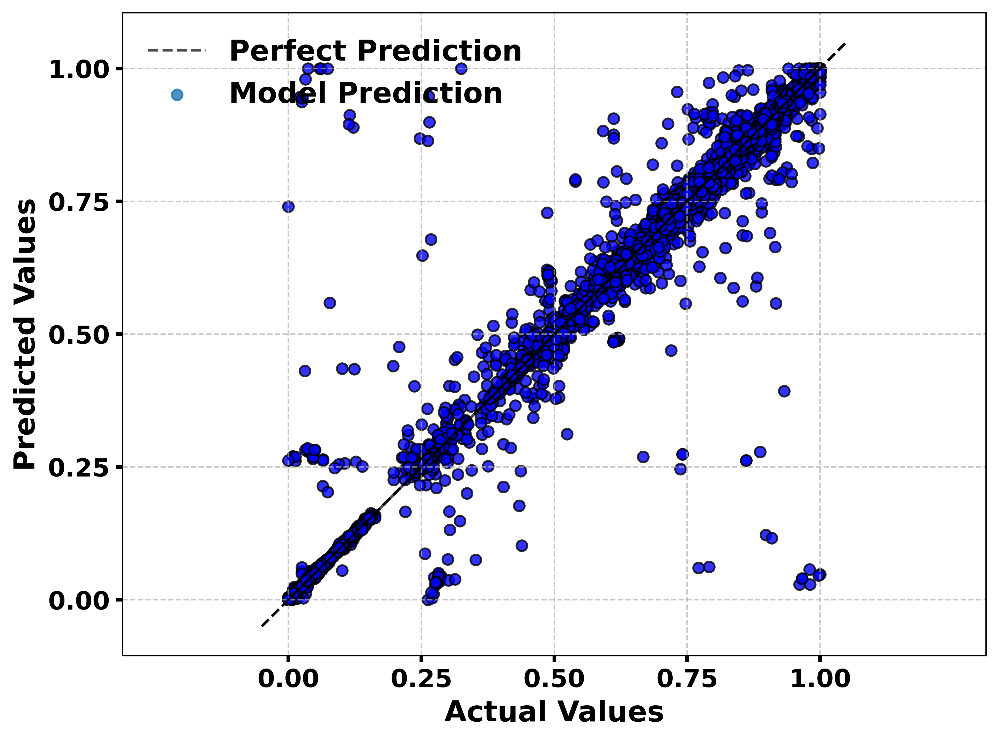

R² Score: 0.9175
Mean Absolute Error (MAE): 0.0139
Mean Squared Error (MSE): 0.0034
Explained Variance Score: 0.9175



In [41]:
# IMPORT DECISION TREE REGRESSOR
from sklearn import tree

# INITIALIZE DECISION TREE REGRESSOR
clf = tree.DecisionTreeRegressor()

# FIT THE DECISION TREE REGRESSION MODEL
clf.fit(X_train_scaled, y_train_scaled)

# EVALUATE THE PERFORMANCE OF THE DECISION TREE MODEL
print_metrics("DecisionTree", "DECISION TREE REGRESSION", clf, X_test_scaled, y_test_scaled)

### RANDOM FOREST REGRESSION

### **PURPOSE:**  
- **RANDOM FOREST REGRESSION** IS AN ENSEMBLE METHOD THAT USES MULTIPLE DECISION TREES TO IMPROVE PREDICTIONS BY AVERAGING OUT INDIVIDUAL TREE PREDICTIONS.

### **KEY PARAMETERS:**
- **`n_estimators=100`** - NUMBER OF DECISION TREES IN THE FOREST.  
- **`random_state=42`** - ENSURES REPRODUCIBILITY OF RESULTS.


RANDOM FOREST REGRESSION
------------------------


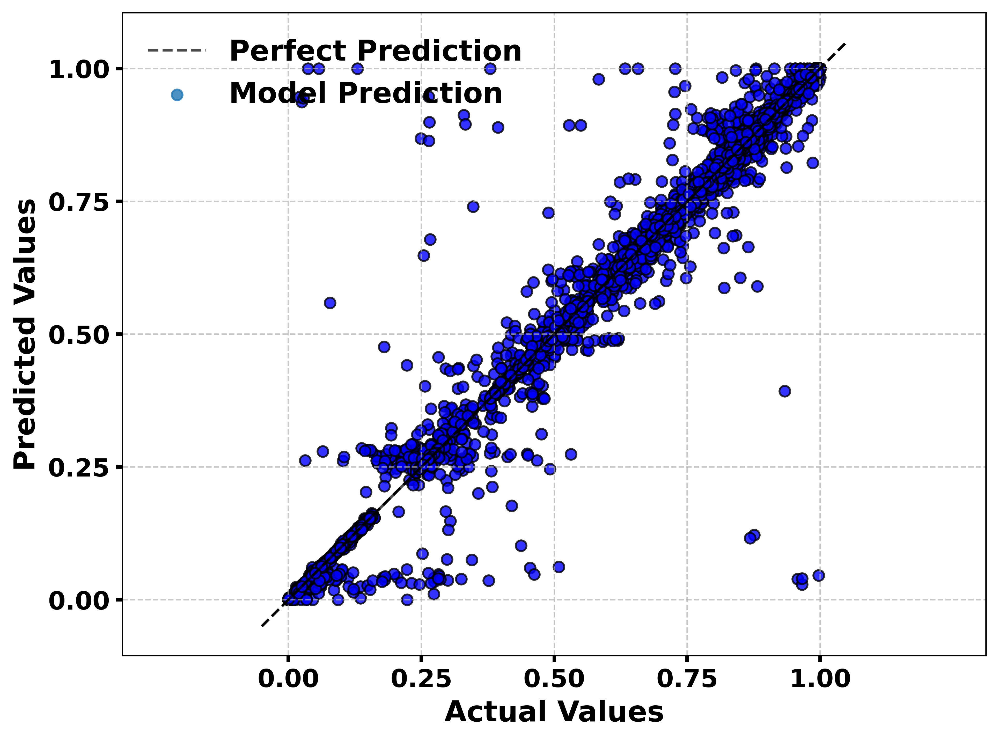

R² Score: 0.9456
Mean Absolute Error (MAE): 0.0118
Mean Squared Error (MSE): 0.0023
Explained Variance Score: 0.9457



In [42]:
# IMPORT RANDOM FOREST REGRESSOR
from sklearn.ensemble import RandomForestRegressor

# INITIALIZE RANDOM FOREST REGRESSOR WITH 100 ESTIMATORS
rf_reg = RandomForestRegressor(n_estimators=100, random_state=42)

# FIT THE RANDOM FOREST REGRESSION MODEL
rf_reg.fit(X_train_scaled, y_train_scaled)

# EVALUATE THE PERFORMANCE OF THE RANDOM FOREST MODEL
print_metrics("RandomForest", "RANDOM FOREST REGRESSION", rf_reg, X_test_scaled, y_test_scaled)